In [23]:
import time, sys
from mido import MidiFile
from scipy import signal
import numpy as np
import IPython.display as ipd
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.widgets import Slider, Button, RadioButtons
from IPython.display import display, clear_output

In [24]:
srate = 44100

# Convert MIDI note number to frequency.
def note_to_freq(note):
    return 440 * 2 ** ((note - 69) / 12)

# Creates triangle sound
def generate_triangle(freq, dur=1, amp=1.0, sr=44100):
    t = np.arange(0, dur, 1.0/sr)
    return 2 * (2*np.floor(freq*t) - np.floor(2*freq*t)) + 1

# this sounds good too, but not so "chiptune". I left it here in case we switch
def triangle_wave(freq:float, dur:float=1.0, sr:float=44100):

    t = np.arange(0, dur, 1.0/sr)
    x = np.zeros(t.shape[0])
    for i in range(4):
        n = 2*i + 1
        x += ((-1)**i)*(n**(-2))*(np.sin(2*np.pi*freq*n*t))
    return (8/(np.pi**2)) * x

# Creates square sound - has a duty cycle of 0.5 as per NES standard
def generate_square(freq:float, dur:float = 1.0, sr:float = 44100):
    t = np.arange(0, dur, 1 / sr)
    s = signal.square(2 * np.pi * freq * t, duty = 0.5)
    return s

# Creates noise sound
def generate_noise(dur:float = 1.0, sr:float = 44100): 
    mu, sigma = 0, 0.1
    t = int(dur * sr)
    s = np.random.normal(mu, sigma, t)
    return s


In [25]:
mid = MidiFile('midi_files/smb_over.mid')
notes = []
notes2 = []
traingle = []
nsf = []
channels = []
channel = -1

for i, track in enumerate(mid.tracks):
    for msg in track:
        if(msg.type == 'program_change'):
            channel += 1

        # Note on event: only counts if velocity is greater than 0 and time grater than 10 ()
        if msg.type == 'note_on' and msg.velocity > 0:
            note = round(note_to_freq(msg.note))
            # Convert time to seconds
            time = msg.time * 0.005
            velocity = msg.velocity
            notes.append(('on', note, time, velocity))
            channels.append(channel)
            
        # Note off event: Basically "pauses"
        elif msg.type == 'note_off' and msg.time > 10:
            note = round(note_to_freq(msg.note))
            time = msg.time * 0.005
            velocity = msg.velocity
            notes.append(('off', note, time, velocity))
            channels.append(channel)

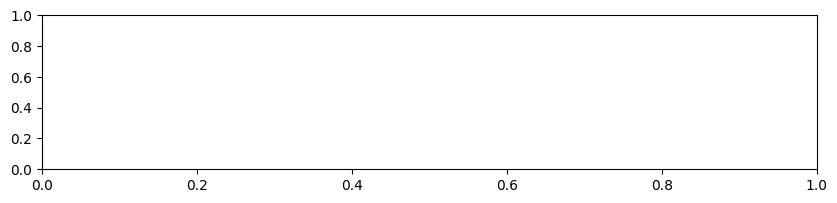

In [38]:
sound_arr = []
sound_arr2 = []
sound_arr3 = []
sound_arr4 = []
fig = plt.figure(figsize=(10, 2))
temp_plot = fig.add_subplot()

for i in range(len(notes) - 1):
    if i == len(notes) - 1:
        break
    currentNote = notes[i]
    nextNote = notes[i + 1]

    if(channels[i] == 0):
        if (currentNote[0] == 'on' and currentNote[3] > 10):
            # Calculating time using delta time between two notes
            sound = generate_square(currentNote[1], dur=nextNote[2])
            sound_arr = np.hstack([sound_arr,sound])
    
        elif (currentNote[0] == 'off'):
            sound = generate_square(0, dur=nextNote[2])
            sound_arr = np.hstack([sound_arr,sound])

    elif(channels[i] == 1):
        if (currentNote[0] == 'on' and currentNote[3] > 10):
            # Calculating time using delta time between two notes
            sound = generate_square(currentNote[1], dur=nextNote[2])
            sound_arr2 = np.hstack([sound_arr2,sound])
    
        elif (currentNote[0] == 'off'):
            sound = generate_square(0, dur=nextNote[2])
            sound_arr2 = np.hstack([sound_arr2,sound])

    elif(channels[i] == 2):
        if (currentNote[0] == 'on' and currentNote[3] > 10):
            # Calculating time using delta time between two notes
            sound = generate_triangle(currentNote[1], dur=nextNote[2])
            sound_arr3 = np.hstack([sound_arr3,sound])
    
        elif (currentNote[0] == 'off'):
            sound = generate_triangle(0, dur=nextNote[2])
            sound_arr3 = np.hstack([sound_arr3,sound])

    if(channels[i] == 3):
        if (currentNote[0] == 'on' and currentNote[3] > 10):
            # Calculating time using delta time between two notes
            sound = generate_noise(dur=nextNote[2])
            sound_arr4 = np.hstack([sound_arr4,sound])
    
        elif (currentNote[0] == 'off'):
            sound = generate_noise(dur=nextNote[2])
            sound_arr4 = np.hstack([sound_arr4,sound])

In [44]:
# just using the first minute as the entire music (5 min) takes long to process
ipd.Audio(sound_arr, rate=srate)

In [36]:
ipd.Audio(sound_arr2, rate=srate)

In [39]:
ipd.Audio(sound_arr3, rate=srate)

In [40]:
ipd.Audio(sound_arr4, rate=srate)

In [32]:
f = open('mario.nsf' , "rb")
#dump the header
f.read(128)

for value in f:
    # if b'\x' in value:
    #     value = value.removeprefix(b'\x')
    print(value)
# print(f.read())


b'H\xa2\x00\xbd\x00\xbe\x95\x00\xe8\xd0\xf8\xbd\x00\xbf\x9d\x00\x07\xe8\xd0\xf7h\xa0\x07\xc9\r\x90\t8\xe9\r\xa0\x00\xa2@\x86\xfc\xc9\x07\x90\x04\xc88\xe9\x07\xaa\xa9\x01\xe0\x00\xf0\x05\n'
b'\xcaL\xf3\xbd\x99\xf4\x00`\x00O\xd0\x01\x00( \x00\x05\xeb\x00\x00\x00\x00\x08\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\xaa\xbdD\xbe\xa2\x00L\xc4\xbd\x00\x00\x00\x00\x00\x00\x00\x00\x02\x01\x03\x04\x0c\n'
b"\x07\x08\x0b\x05\t\r\x0f\x0e\x10\x11\x12\x13\x14\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00(`````\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x